In [ ]:
# Load the IMDB dataset
(x_train, y_train), (x_test, y_test) = tf.keras.datasets.imdb.load_data()

In [ ]:
print('Training data shape:', x_train.shape)
print('Training labels shape:', y_train.shape)
print('Testing data shape:', x_test.shape)
print('Testing labels shape:', y_test.shape)

# Import Library

In [ ]:
!pip install bertviz

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/


In [ ]:
!pip uninstall numpy

Found existing installation: numpy 1.22.4
Uninstalling numpy-1.22.4:
  Would remove:
    /usr/local/bin/f2py
    /usr/local/bin/f2py3
    /usr/local/bin/f2py3.9
    /usr/local/lib/python3.9/dist-packages/numpy-1.22.4.dist-info/*
    /usr/local/lib/python3.9/dist-packages/numpy.libs/libgfortran-040039e1.so.5.0.0
    /usr/local/lib/python3.9/dist-packages/numpy.libs/libopenblas64_p-r0-2f7c42d4.3.18.so
    /usr/local/lib/python3.9/dist-packages/numpy.libs/libquadmath-96973f99.so.0.0.0
    /usr/local/lib/python3.9/dist-packages/numpy/*
Proceed (Y/n)? Y
  Successfully uninstalled numpy-1.22.4


In [ ]:
!pip install numpy==1.23

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/


In [ ]:
!pip install -q tf-models-official==2.11.0

In [ ]:
!pip install -U tensorflow-text==2.11.0

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/


In [3]:
import tensorflow_hub as hub
import tensorflow_text as text
import tensorflow as tf
import urllib.request
import tarfile
import os
import copy
import sys
import numpy as np
import random as rn
import pandas as pd
import matplotlib.pyplot as plt
# from sklearn.model_selection import train_test_split
import shutil
import seaborn as sns
%matplotlib inline
import itertools

# Data

In [ ]:
# URL for the dataset
url = "http://ai.stanford.edu/~amaas/data/sentiment/aclImdb_v1.tar.gz"

# Download and extract the dataset
filename, _ = urllib.request.urlretrieve(url)
with tarfile.open(filename, "r:gz") as tar:
    tar.extractall()

# Get the directories for each set of reviews
train_dir = os.path.join("aclImdb", "train")
test_dir = os.path.join("aclImdb", "test")
pos_train_dir = os.path.join(train_dir, "pos")
neg_train_dir = os.path.join(train_dir, "neg")
pos_test_dir = os.path.join(test_dir, "pos")
neg_test_dir = os.path.join(test_dir, "neg")


In [ ]:
# Read the contents of each file into variables
pos_train_files = [os.path.join(pos_train_dir, f) for f in os.listdir(pos_train_dir)]
pos_train_reviews = []
for file in pos_train_files:
    with open(file, "r") as f:
        pos_train_reviews.append(f.read())

neg_train_files = [os.path.join(neg_train_dir, f) for f in os.listdir(neg_train_dir)]
neg_train_reviews = []
for file in neg_train_files:
    with open(file, "r") as f:
        neg_train_reviews.append(f.read())

pos_test_files = [os.path.join(pos_test_dir, f) for f in os.listdir(pos_test_dir)]
pos_test_reviews = []
for file in pos_test_files:
    with open(file, "r") as f:
        pos_test_reviews.append(f.read())

neg_test_files = [os.path.join(neg_test_dir, f) for f in os.listdir(neg_test_dir)]
neg_test_reviews = []
for file in neg_test_files:
    with open(file, "r") as f:
        neg_test_reviews.append(f.read())

# Print the first review in each set
print("Train set:")
print("Positive review:", pos_train_reviews[0])
print("Negative review:", neg_train_reviews[0])
print("Test set:")
print("Positive review:", pos_test_reviews[0])
print("Negative review:", neg_test_reviews[0])

Train set:
Positive review: One more of those brilliant young men who went all out and dared to make a teen romance film( can i actually call it that?- it would invoke the devil out of its fans)on a micro budget but packed with such taste, sensitiveness and maturity. Peter Sollett- you deserve more admiration and respect.Thanks once again for demonstrating to the powers that be in the "industry" that stereotypes can be flushed down the toilet. One location,a handful of rich characters, low budget,good acting(and that too amateurs),decent lighting - worshippers of true indie cinema should watch more of this and STOP watching...well...you know what.
Negative review: If you have seen Friends, the writing will feel very familiar. Especially the last 3 or 4 seasons of Friends often share the same comedy setups.<br /><br />The show is about a group of people whose connection is that they shared the same class when they were still rather young (about 10 years old I think). Now, they're in the

In [ ]:
df_pos_train = pd.DataFrame(pos_train_reviews, columns=['Review'])
df_pos_train = df_pos_train.assign(Label=1)
df_neg_train = pd.DataFrame(neg_train_reviews, columns=['Review'])
df_neg_train = df_neg_train.assign(Label=0)

In [ ]:
df_pos_train

,Review,Label
0,One more of those brilliant young men who went...,1
1,".......Playing Kaddiddlehopper, Col San Fernan...",1
2,I can only agree with taximeter that this is a...,1
3,"Of all the reviews I've read, most people have...",1
4,"In the early to mid 1970's, Clifford Irving pr...",1
...,...,...
12495,Thought at first this film would be your typic...,1
12496,This one's a romp; many Trek fans don't rate t...,1
12497,"Though I like E.E. ""Doc"" Smith's books and Dav...",1
12498,"Although I gave a rating of ""9"", my expectatio...",1


In [ ]:
def build_train_test (pos_list, neg_list):
  df_pos = pd.DataFrame(pos_list, columns=['Review'])
  df_pos = df_pos.assign(Label=1)
  df_neg = pd.DataFrame(neg_list, columns=['Review'])
  df_neg = df_neg.assign(Label=0)
  df = pd.concat([df_pos, df_neg])
  df = df.reset_index(drop=True)
  return df

In [ ]:
df_train = build_train_test(pos_train_reviews,  neg_train_reviews)
df_test = build_train_test(pos_test_reviews, pos_test_reviews)

### shuffle the data

In [ ]:
df_train = df_train.sample(frac = 1)
df_train

,Review,Label
16504,After buying the DVD in a Bargain Bin due to t...,0
7905,"May 2004, Wonderland is fairly new in the UK. ...",1
434,Alright this was quite a sensitive little numb...,1
7108,So your bairns are away on a sleep-over ? The ...,1
5893,Not to be confused with the Resse Witherspoon ...,1
...,...,...
14287,"""The Bat People"" is a proud resident of the IM...",0
19331,"Giving credit where it's due, only the technic...",0
14831,"First of all, I was expecting ""Caged Heat"" to ...",0
5738,My mother and I were on our way home from a tr...,1


In [ ]:
df_test = df_test.sample(frac = 1)
df_test

,Review,Label
6237,I have to say that this film was excellently p...,1
10399,This documentary is the most hypnotizing film ...,1
704,My 10/10 rating of course applies only if you'...,1
21453,"Victor Mature, as a barely civilized and mostl...",0
4459,I've been a fan of Heaven's Gate since its fir...,1
...,...,...
7639,"This is the kind of film they used to make, am...",1
16778,"Admittedly, there are some scenes in this movi...",0
18606,I stumbled across this film while channel surf...,0
2969,"The Blue Planet series is, without a doubt, on...",1


In [ ]:
x_train = df_train.head(17500)
x_test = df_test.tail(7500)

In [ ]:
y_train = df_train['Label']
y_test = df_test['Label']

In [ ]:
df = pd.concat([df_train, df_test])
df

,Review,Label
16504,After buying the DVD in a Bargain Bin due to t...,0
7905,"May 2004, Wonderland is fairly new in the UK. ...",1
434,Alright this was quite a sensitive little numb...,1
7108,So your bairns are away on a sleep-over ? The ...,1
5893,Not to be confused with the Resse Witherspoon ...,1
...,...,...
7639,"This is the kind of film they used to make, am...",1
16778,"Admittedly, there are some scenes in this movi...",0
18606,I stumbled across this film while channel surf...,0
2969,"The Blue Planet series is, without a doubt, on...",1


In [ ]:
df_train.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 25000 entries, 16504 to 3907
Data columns (total 2 columns):
 #   Column  Non-Null Count  Dtype 
---  ------  --------------  ----- 
 0   Review  25000 non-null  object
 1   Label   25000 non-null  int64 
dtypes: int64(1), object(1)
memory usage: 585.9+ KB


In [ ]:
df_test.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 25000 entries, 6237 to 23640
Data columns (total 2 columns):
 #   Column  Non-Null Count  Dtype 
---  ------  --------------  ----- 
 0   Review  25000 non-null  object
 1   Label   25000 non-null  int64 
dtypes: int64(1), object(1)
memory usage: 585.9+ KB


In [ ]:
df_train.head()

,Review,Label
16504,After buying the DVD in a Bargain Bin due to t...,0
7905,"May 2004, Wonderland is fairly new in the UK. ...",1
434,Alright this was quite a sensitive little numb...,1
7108,So your bairns are away on a sleep-over ? The ...,1
5893,Not to be confused with the Resse Witherspoon ...,1


In [ ]:
df_train.tail()

,Review,Label
14287,"""The Bat People"" is a proud resident of the IM...",0
19331,"Giving credit where it's due, only the technic...",0
14831,"First of all, I was expecting ""Caged Heat"" to ...",0
5738,My mother and I were on our way home from a tr...,1
3907,"""Antwone Fisher"" tells of a young black U.S. N...",1


In [ ]:
df_test.head()

,Review,Label
6237,I have to say that this film was excellently p...,1
10399,This documentary is the most hypnotizing film ...,1
704,My 10/10 rating of course applies only if you'...,1
21453,"Victor Mature, as a barely civilized and mostl...",0
4459,I've been a fan of Heaven's Gate since its fir...,1


In [ ]:
df_test.tail()

,Review,Label
7639,"This is the kind of film they used to make, am...",1
16778,"Admittedly, there are some scenes in this movi...",0
18606,I stumbled across this film while channel surf...,0
2969,"The Blue Planet series is, without a doubt, on...",1
23640,"I mean let's face it, all you have to do in mo...",0


In [ ]:
df_train.groupby('Label').describe()

Review                                                               
       count unique                                                top freq
Label                                                                      
0      12500  12432  When i got this movie free from my job, along ...    3
1      12500  12472  I Enjoyed Watching This Well Acted Movie Very ...    2

In [ ]:
x_train = df_train['Review']
y_train = df_train['Label']
x_test = df_test['Review']
y_test = df_test['Label']

In [ ]:
x_train.head(), y_train.head()

(16504    After buying the DVD in a Bargain Bin due to t...
 7905     May 2004, Wonderland is fairly new in the UK. ...
 434      Alright this was quite a sensitive little numb...
 7108     So your bairns are away on a sleep-over ? The ...
 5893     Not to be confused with the Resse Witherspoon ...
 Name: Review, dtype: object,
 16504    0
 7905     1
 434      1
 7108     1
 5893     1
 Name: Label, dtype: int64)

In [ ]:
x_train.tail(), y_train.tail()

(14287    "The Bat People" is a proud resident of the IM...
 19331    Giving credit where it's due, only the technic...
 14831    First of all, I was expecting "Caged Heat" to ...
 5738     My mother and I were on our way home from a tr...
 3907     "Antwone Fisher" tells of a young black U.S. N...
 Name: Review, dtype: object,
 14287    0
 19331    0
 14831    0
 5738     1
 3907     1
 Name: Label, dtype: int64)

## Exploratory Data Analysis

the length of the reviews

In [ ]:
import plotly
import plotly.graph_objs as go
import matplotlib.pyplot as plt
from wordcloud import WordCloud,STOPWORDS

In [ ]:
lens = x_train.str.len()

fig = go.Figure()
fig.add_trace(
    go.Histogram(x=lens, xbins=dict(size=200))
    )
fig.update_layout(title='Length of reviews', 
                    xaxis_title="Length",
                    yaxis_title="# of reviews")
plotly.offline.iplot(fig)

In [ ]:
lens = x_test.str.len()

fig = go.Figure()
fig.add_trace(
    go.Histogram(x=lens, xbins=dict(size=200))
    )
fig.update_layout(title='Length of reviews', 
                    xaxis_title="Length",
                    yaxis_title="# of reviews")
plotly.offline.iplot(fig)

In [ ]:
poslens = df_pos_train['Review'].str.len()
neglens = df_neg_train['Review'].str.len()
fig = go.Figure()
fig.add_trace(
    go.Histogram(x=poslens, xbins=dict(size=200), name='positive'),
    )
fig.add_trace(
    go.Histogram(x=neglens, xbins=dict(size=200), name='negative'),
    )
fig.update_layout(title='Length of reviews of training data', 
                    xaxis_title="Length",
                    yaxis_title="# of reviews",)
plotly.offline.iplot(fig)

# Data using Tensorflow

In [ ]:
url = 'https://ai.stanford.edu/~amaas/data/sentiment/aclImdb_v1.tar.gz'

dataset = tf.keras.utils.get_file('aclImdb_v1.tar.gz', url,
                                  untar=True, cache_dir='.',
                                  cache_subdir='')

dataset_dir = os.path.join(os.path.dirname(dataset), 'aclImdb')

train_dir = os.path.join(dataset_dir, 'train')

# remove unused folders to make it easier to load the data
remove_dir = os.path.join(train_dir, 'unsup')
shutil.rmtree(remove_dir)

# TF Bert

## Model


In [ ]:
preprocess_url = "https://tfhub.dev/tensorflow/bert_en_uncased_preprocess/3"
encoder_url = "https://tfhub.dev/tensorflow/bert_en_uncased_L-12_H-768_A-12/4"

In [ ]:
bert_preprocess_model = hub.KerasLayer(preprocess_url)
bert_model = hub.KerasLayer(encoder_url)

In [ ]:
AUTOTUNE = tf.data.AUTOTUNE
batch_size = 16
seed = 42

raw_train_ds = tf.keras.utils.text_dataset_from_directory(
    'aclImdb/train',
    batch_size=batch_size,
    validation_split=0.2,
    subset='training',
    seed=seed)

class_names = raw_train_ds.class_names
train_ds = raw_train_ds.cache().prefetch(buffer_size=AUTOTUNE)

val_ds = tf.keras.utils.text_dataset_from_directory(
    'aclImdb/train',
    batch_size=batch_size,
    validation_split=0.2,
    subset='validation',
    seed=seed)

val_ds = val_ds.cache().prefetch(buffer_size=AUTOTUNE)

test_ds = tf.keras.utils.text_dataset_from_directory(
    'aclImdb/test',
    batch_size=batch_size)

test_ds = test_ds.cache().prefetch(buffer_size=AUTOTUNE)

Found 25000 files belonging to 2 classes.
Using 20000 files for training.
Found 25000 files belonging to 2 classes.
Using 5000 files for validation.
Found 25000 files belonging to 2 classes.


In [ ]:
def build_classifier_model():
  text_input = tf.keras.layers.Input(shape=(), dtype=tf.string, name='text')
  preprocessing_layer = hub.KerasLayer(preprocess_url, name='preprocessing')
  encoder_inputs = preprocessing_layer(text_input)
  encoder = hub.KerasLayer(encoder_url, trainable=True, name='BERT_encoder')
  outputs = encoder(encoder_inputs)
  net = outputs['pooled_output']
  net = tf.keras.layers.Dropout(0.1)(net)
  net = tf.keras.layers.Dense(1, activation=None, name='classifier')(net)
  return tf.keras.Model(text_input, net)

In [ ]:
model_ver1 = build_classifier_model()

Instructions for updating:
Lambda fuctions will be no more assumed to be used in the statement where they are used, or at least in the same block. https://github.com/tensorflow/tensorflow/issues/56089


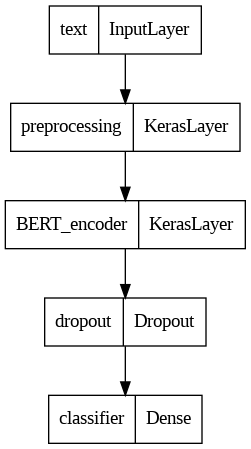

In [ ]:
tf.keras.utils.plot_model(model_ver1)

loss function

In [ ]:
loss = tf.keras.losses.BinaryCrossentropy(from_logits=True)
metrics = [
    tf.keras.metrics.BinaryAccuracy(name='Accuracy'),
    tf.keras.metrics.Precision(name='Precision'),
    tf.keras.metrics.Recall(name='Recall'),
    tf.metrics.BinaryAccuracy()
]

In [ ]:
from official.nlp import optimization
epochs = 5
steps_per_epoch = tf.data.experimental.cardinality(train_ds).numpy()
num_train_steps = steps_per_epoch * epochs
num_warmup_steps = int(0.1*num_train_steps)

init_lr = 3e-5
optimizer = optimization.create_optimizer(init_lr=init_lr,
                                          num_train_steps=num_train_steps,
                                          num_warmup_steps=num_warmup_steps,
                                          optimizer_type='adamw')

/usr/local/lib/python3.9/dist-packages/tensorflow_addons/utils/tfa_eol_msg.py:23: UserWarning: 

TensorFlow Addons (TFA) has ended development and introduction of new features.
TFA has entered a minimal maintenance and release mode until a planned end of life in May 2024.
Please modify downstream libraries to take dependencies from other repositories in our TensorFlow community (e.g. Keras, Keras-CV, and Keras-NLP). 

For more information see: https://github.com/tensorflow/addons/issues/2807 

  warnings.warn(


In [ ]:
model_ver1.compile(optimizer=optimizer,
                         loss=loss,
                         metrics=metrics)

In [ ]:
print(f'Training model with {encoder_url}')
history = model_ver1.fit(x=train_ds,
                               validation_data=val_ds,
                               epochs=epochs)

Training model with https://tfhub.dev/tensorflow/bert_en_uncased_L-12_H-768_A-12/4
Epoch 1/5
1250/1250 [==============================] - 126s 86ms/step - loss: 0.3966 - Accuracy: 0.8115 - Precision: 0.8607 - Recall: 0.7415 - binary_accuracy: 0.8115 - val_loss: 0.3189 - val_Accuracy: 0.8794 - val_Precision: 0.8787 - val_Recall: 0.8846 - val_binary_accuracy: 0.8794
Epoch 2/5
1250/1250 [==============================] - 107s 85ms/step - loss: 0.2293 - Accuracy: 0.9147 - Precision: 0.9263 - Recall: 0.9003 - binary_accuracy: 0.9147 - val_loss: 0.4340 - val_Accuracy: 0.8652 - val_Precision: 0.9291 - val_Recall: 0.7951 - val_binary_accuracy: 0.8652
Epoch 3/5
1250/1250 [==============================] - 106s 85ms/step - loss: 0.1276 - Accuracy: 0.9631 - Precision: 0.9670 - Recall: 0.9586 - binary_accuracy: 0.9631 - val_loss: 0.5495 - val_Accuracy: 0.8824 - val_Precision: 0.9056 - val_Recall: 0.8578 - val_binary_accuracy: 0.8824
Epoch 4/5
1250/1250 [==============================] - 106s 85ms/

dict_keys(['loss', 'Accuracy', 'Precision', 'Recall', 'binary_accuracy', 'val_loss', 'val_Accuracy', 'val_Precision', 'val_Recall', 'val_binary_accuracy'])


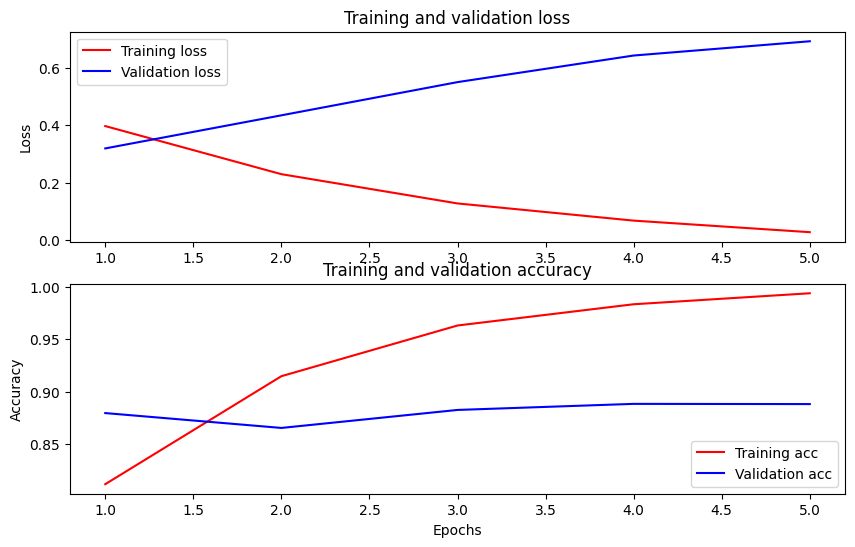

In [ ]:
history_dict = history.history
print(history_dict.keys())

acc = history_dict['binary_accuracy']
val_acc = history_dict['val_binary_accuracy']
loss = history_dict['loss']
val_loss = history_dict['val_loss']

epochs = range(1, len(acc) + 1)
fig = plt.figure(figsize=(10, 6))
fig.tight_layout()

plt.subplot(2, 1, 1)
# r is for "solid red line"
plt.plot(epochs, loss, 'r', label='Training loss')
# b is for "solid blue line"
plt.plot(epochs, val_loss, 'b', label='Validation loss')
plt.title('Training and validation loss')
# plt.xlabel('Epochs')
plt.ylabel('Loss')
plt.legend()

plt.subplot(2, 1, 2)
plt.plot(epochs, acc, 'r', label='Training acc')
plt.plot(epochs, val_acc, 'b', label='Validation acc')
plt.title('Training and validation accuracy')
plt.xlabel('Epochs')
plt.ylabel('Accuracy')
plt.legend(loc='lower right')

In [ ]:
result = model_ver1.evaluate(test_ds)

1563/1563 [==============================] - 56s 36ms/step - loss: 0.6850 - Accuracy: 0.8873 - Precision: 0.8874 - Recall: 0.8871 - binary_accuracy: 0.8873


In [ ]:
loss, Accuracy, Precision, Recall, binary_accuracy = result 
print(f'Loss: {loss}')
print(f'Accuracy: {Accuracy}')
print(f'Precision: {Precision}')
print(f'Recall: {Recall}')
print(f'Binary Accuracy: {binary_accuracy}')

Loss: 0.6849831938743591
Accuracy: 0.8872799873352051
Precision: 0.8874039649963379
Recall: 0.8871200084686279
Binary Accuracy: 0.8872799873352051


In [ ]:
y_predicted = model_ver1.predict(test_ds)

1563/1563 [==============================] - 53s 33ms/step


In [ ]:
y_predicted

array([[  9.042469 ],
       [-10.64011  ],
       [  8.731815 ],
       ...,
       [  8.191098 ],
       [ -9.459516 ],
       [  7.3560686]], dtype=float32)

In [ ]:
y_predicted = y_predicted.flatten()
y_predicted = np.where(y_predicted>0.5, 1, 0)
y_predicted

array([1, 0, 1, ..., 1, 0, 1])

In [ ]:
test_text = []
test_labels = []
for text_batch, label_batch in test_ds:
    test_text.append(text_batch.numpy())
    test_labels.append(label_batch.numpy())

test_text = np.concatenate(test_text, axis=0)
test_labels = np.concatenate(test_labels, axis=0)

In [ ]:
test_labels

array([1, 0, 1, ..., 1, 0, 1], dtype=int32)

In [ ]:
print(np.__version__)

1.23.0


In [ ]:
from sklearn.metrics import confusion_matrix, classification_report
cm = confusion_matrix(test_labels, y_predicted)
cm

array([[11093,  1407],
       [ 1411, 11089]])

Text(0.5, 1.0, 'Confusion Matrix of BERT Model')

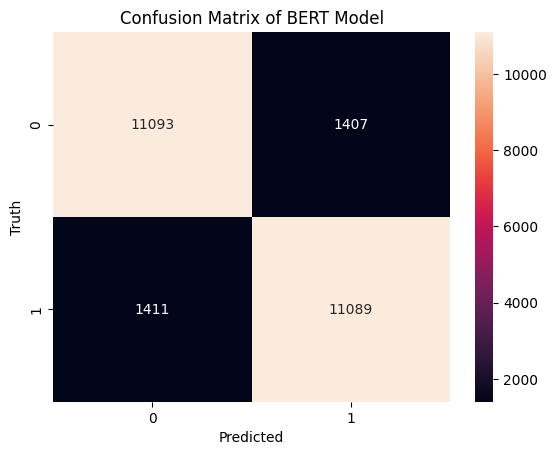

In [ ]:
import seaborn as sn
sn.heatmap(cm, annot=True, fmt = 'd')
plt.xlabel('Predicted')
plt.ylabel('Truth')
plt.title('Confusion Matrix of BERT Model')

In [ ]:
print(classification_report(test_labels, y_predicted))

              precision    recall  f1-score   support

           0       0.89      0.89      0.89     12500
           1       0.89      0.89      0.89     12500

    accuracy                           0.89     25000
   macro avg       0.89      0.89      0.89     25000
weighted avg       0.89      0.89      0.89     25000



## Reload saved model

In [ ]:
dataset_name = 'imdb'
saved_model_path = './{}_bert'.format(dataset_name.replace('/', '_'))

model_ver1.save(saved_model_path, include_optimizer=False)

In [ ]:
model_path = './drive/MyDrive/imdb_bert'

In [ ]:
reloaded_model = tf.saved_model.load(model_path)

In [ ]:
def print_my_examples(inputs, results):
  result_for_printing = \
    [f'input: {inputs[i]:<30} : score: {results[i][0]:.6f}'
                         for i in range(len(inputs))]
  print(*result_for_printing, sep='\n')
  print()


examples = [
    'this is such an amazing movie!',  # this is the same sentence tried earlier
    'The movie was great!',
    'The movie was meh.',
    'The movie was okish.',
    'The movie was terrible...'
]

reloaded_results = tf.sigmoid(reloaded_model(tf.constant(examples)))
# original_results = tf.sigmoid(model_ver1(tf.constant(examples)))

print('Results from the saved model:')
print_my_examples(examples, reloaded_results)
# print('Results from the model in memory:')
# print_my_examples(examples, original_results)

In [ ]:
misclassified_indices = np.where(y_predicted != test_labels)[0]

In [ ]:
misclassified_indices

# Pytorch Bert

## Data import


In [ ]:
import transformers
from transformers import BertModel, BertTokenizer, AdamW, get_linear_schedule_with_warmup
import torch

import numpy as np
import pandas as pd
import seaborn as sns
from pylab import rcParams
import matplotlib.pyplot as plt
from matplotlib import rc
from sklearn.model_selection import train_test_split
from sklearn.metrics import confusion_matrix, classification_report
from collections import defaultdict
from textwrap import wrap

from torch import nn, optim
from torch.utils.data import Dataset, DataLoader
import torch.nn.functional as F

%matplotlib inline
import urllib.request
import tarfile
import os
import copy
import sys
import tensorflow as tf
from torch.utils.data import TensorDataset, DataLoader, RandomSampler, SequentialSampler
import random as rn
from torch.optim import Adam
from torch.nn.utils import clip_grad_norm_
from IPython.display import clear_output

In [ ]:
from tensorflow.keras.utils import pad_sequences

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
import os
for dirname, _, filenames in os.walk('/content/drive/MyDrive/input'):
    for filename in filenames:
        print(os.path.join(dirname, filename))

/content/drive/MyDrive/input/test.csv
/content/drive/MyDrive/input/train.csv


In [ ]:
path = '/content/drive/MyDrive/input/'

train_data = pd.read_csv(path + 'train.csv')
test_data = pd.read_csv(path + 'test.csv')

In [ ]:
train_data = train_data.to_dict(orient='records')
test_data = test_data.to_dict(orient='records')
type(train_data)

list

In [ ]:
train_texts, train_labels = list(zip(*map(lambda d: (d['text'], d['sentiment']), train_data)))
test_texts, test_labels = list(zip(*map(lambda d: (d['text'], d['sentiment']), test_data)))

len(train_texts), len(train_labels), len(test_texts), len(test_labels)

(25000, 25000, 25000, 25000)

In [ ]:
tokenizer = BertTokenizer.from_pretrained('bert-base-uncased', do_lower_case=True)

In [ ]:
train_tokens = list(map(lambda t: ['[CLS]'] + tokenizer.tokenize(t)[:510] + ['[SEP]'], train_texts))
test_tokens = list(map(lambda t: ['[CLS]'] + tokenizer.tokenize(t)[:510] + ['[SEP]'], test_texts))

len(train_tokens), len(test_tokens)

(25000, 25000)

In [ ]:
train_tokens_ids = pad_sequences(list(map(tokenizer.convert_tokens_to_ids, train_tokens)), maxlen=512, truncating="post", padding="post", dtype="int")
test_tokens_ids = pad_sequences(list(map(tokenizer.convert_tokens_to_ids, test_tokens)), maxlen=512, truncating="post", padding="post", dtype="int")

train_tokens_ids.shape, test_tokens_ids.shape

((25000, 512), (25000, 512))

In [ ]:
train_y = np.array(train_labels) == 'pos'
test_y = np.array(test_labels) == 'pos'
train_y.shape, test_y.shape, np.mean(train_y), np.mean(test_y)

((25000,), (25000,), 0.5, 0.5)

In [ ]:
train_masks = [[float(i > 0) for i in ii] for ii in train_tokens_ids]
test_masks = [[float(i > 0) for i in ii] for ii in test_tokens_ids]

## baseline

In [ ]:
from sklearn.feature_extraction.text import CountVectorizer
from sklearn.linear_model import LogisticRegression
from sklearn.pipeline import make_pipeline
from sklearn.metrics import classification_report

In [ ]:
baseline_model = make_pipeline(CountVectorizer(ngram_range=(1,3)), LogisticRegression()).fit(train_texts[:2000], train_labels[:2000])

/usr/local/lib/python3.9/dist-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


In [ ]:
baseline_predicted = baseline_model.predict(test_texts[:500])

In [ ]:
print(classification_report(test_labels[:500], baseline_predicted))

              precision    recall  f1-score   support

         neg       0.82      0.84      0.83       246
         pos       0.84      0.83      0.83       254

    accuracy                           0.83       500
   macro avg       0.83      0.83      0.83       500
weighted avg       0.83      0.83      0.83       500



## Bert

In [ ]:
import gc

In [ ]:
gc.collect()
torch.cuda.empty_cache()

In [ ]:
class BertBinaryClassifier(nn.Module):
    def __init__(self, dropout=0.1):
        super(BertBinaryClassifier, self).__init__()

        self.bert = BertModel.from_pretrained('bert-base-uncased', output_attentions=True)

        self.dropout = nn.Dropout(dropout)
        self.linear = nn.Linear(768, 1)
        self.sigmoid = nn.Sigmoid()
        self.attentions = None
    
    def forward(self, tokens, masks=None):
        output = self.bert(tokens, attention_mask=masks)
        dropout_output = self.dropout(output['pooler_output'])
        linear_output = self.linear(dropout_output)
        proba = self.sigmoid(linear_output)
        self.attentions = output['attentions']
        return proba

In [ ]:
rn.seed(321)
np.random.seed(321)
torch.manual_seed(321)
torch.cuda.manual_seed(321)

In [ ]:
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
device

device(type='cuda')

In [ ]:
torch.cuda.empty_cache()

In [ ]:
str(torch.cuda.memory_allocated(device)/1000000 ) + 'M'

'0.0M'

In [ ]:
bert_clf = BertBinaryClassifier()
bert_clf = bert_clf.cuda()

Some weights of the model checkpoint at bert-base-uncased were not used when initializing BertModel: ['cls.predictions.transform.dense.weight', 'cls.predictions.transform.LayerNorm.bias', 'cls.predictions.transform.dense.bias', 'cls.predictions.transform.LayerNorm.weight', 'cls.seq_relationship.weight', 'cls.predictions.bias', 'cls.seq_relationship.bias', 'cls.predictions.decoder.weight']
- This IS expected if you are initializing BertModel from the checkpoint of a model trained on another task or with another architecture (e.g. initializing a BertForSequenceClassification model from a BertForPreTraining model).
- This IS NOT expected if you are initializing BertModel from the checkpoint of a model that you expect to be exactly identical (initializing a BertForSequenceClassification model from a BertForSequenceClassification model).


In [ ]:
str(torch.cuda.memory_allocated(device)/1000000 ) + 'M'

'3441.627648M'

## model

In [ ]:
BATCH_SIZE = 16
EPOCHS = 2

In [ ]:
train_tokens_tensor = torch.tensor(train_tokens_ids)
train_y_tensor = torch.tensor(train_y.reshape(-1, 1)).float()

test_tokens_tensor = torch.tensor(test_tokens_ids)
test_y_tensor = torch.tensor(test_y.reshape(-1, 1)).float()

train_masks_tensor = torch.tensor(train_masks)
test_masks_tensor = torch.tensor(test_masks)

str(torch.cuda.memory_allocated(device)/1000000 ) + 'M'

'3441.627648M'

In [ ]:
train_dataset = TensorDataset(train_tokens_tensor, train_masks_tensor, train_y_tensor)
train_sampler = RandomSampler(train_dataset)
train_dataloader = DataLoader(train_dataset, sampler=train_sampler, batch_size=BATCH_SIZE)

test_dataset = TensorDataset(test_tokens_tensor, test_masks_tensor, test_y_tensor)
test_sampler = SequentialSampler(test_dataset)
test_dataloader = DataLoader(test_dataset, sampler=test_sampler, batch_size=BATCH_SIZE)

In [ ]:
param_optimizer = list(bert_clf.sigmoid.named_parameters()) 
optimizer_grouped_parameters = [{"params": [p for n, p in param_optimizer]}]

In [ ]:
param_optimizer

[]

In [ ]:
optimizer_grouped_parameters

[{'params': []}]

In [ ]:
optimizer = Adam(bert_clf.parameters(), lr=5e-6)

In [ ]:
loss_history = []
for epoch_num in range(EPOCHS):
    bert_clf.train()
    train_loss = 0
    for step_num, batch_data in enumerate(train_dataloader):
        token_ids, masks, labels = tuple(t.to(device) for t in batch_data)
        print(str(torch.cuda.memory_allocated(device)/1000000 ) + 'M')
        logits = bert_clf(token_ids, masks)
        
        loss_func = nn.BCELoss()

        batch_loss = loss_func(logits, labels)
        train_loss += batch_loss.item()
        gc.collect()
        
        bert_clf.zero_grad()
        batch_loss.backward()
        

        clip_grad_norm_(parameters=bert_clf.parameters(), max_norm=1.0)
        optimizer.step()
        
        clear_output(wait=True)
        print('Epoch: ', epoch_num + 1)
        loss = train_loss / (step_num + 1)
        loss_history.append(loss)
        print("\r" + "{0}/{1} loss: {2} ".format(step_num, len(df_train) / BATCH_SIZE, train_loss / (step_num + 1)))

Epoch:  2
1562/1562.5 loss: 0.18305921392760793 


In [ ]:
bert_clf.eval()
bert_test_predicted = []
all_logits = []
with torch.no_grad():
    for step_num, batch_data in enumerate(test_dataloader):

        token_ids, masks, labels = tuple(t.to(device) for t in batch_data)

        logits = bert_clf(token_ids, masks)
        loss_func = nn.BCELoss()
        loss = loss_func(logits, labels)
        numpy_logits = logits.cpu().detach().numpy()
        
        bert_test_predicted += list(numpy_logits[:, 0] > 0.5)
        all_logits += list(numpy_logits[:, 0])

In [ ]:
print(classification_report(test_y, bert_test_predicted))

              precision    recall  f1-score   support

       False       0.92      0.94      0.93     12500
        True       0.94      0.92      0.93     12500

    accuracy                           0.93     25000
   macro avg       0.93      0.93      0.93     25000
weighted avg       0.93      0.93      0.93     25000



<function matplotlib.pyplot.show(close=None, block=None)>

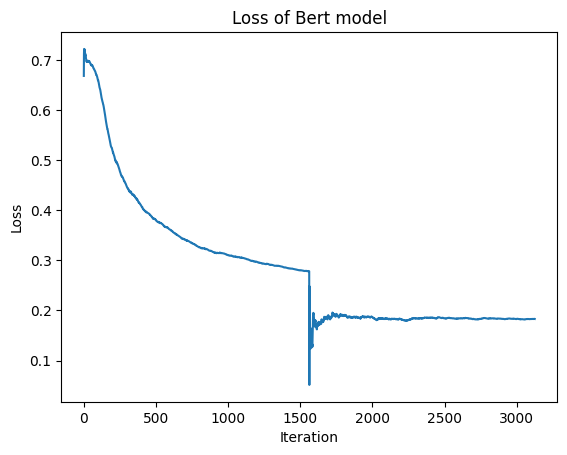

In [ ]:
plt.plot(loss_history)
plt.title('Loss of Bert model')
plt.xlabel('Iteration')
plt.ylabel('Loss')
plt.savefig('Loss of Bert model.png')
plt.show

In [ ]:
from sklearn.metrics import confusion_matrix, classification_report
cm = confusion_matrix(test_y, bert_test_predicted)
cm

array([[11765,   735],
       [  955, 11545]])

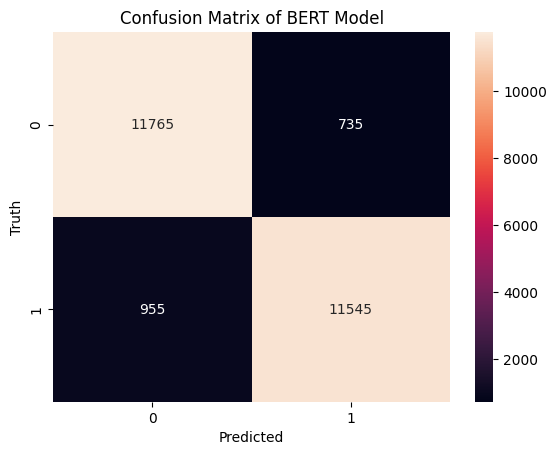

In [ ]:
import seaborn as sn
sn.heatmap(cm, annot=True, fmt = 'd')
plt.xlabel('Predicted')
plt.ylabel('Truth')
plt.title('Confusion Matrix of BERT Model')
plt.savefig('Bert_conf_matrix.png')

In [ ]:
np.where(test_y != bert_test_predicted)[0]

array([    6,     8,    23, ..., 24944, 24950, 24991])

In [ ]:
bert_clf.eval()
bert_train_predicted = []
all_logits = []
with torch.no_grad():
    for step_num, batch_data in enumerate(train_dataloader):

        token_ids, masks, labels = tuple(t.to(device) for t in batch_data)

        logits = bert_clf(token_ids, masks)
        loss_func = nn.BCELoss()
        loss = loss_func(logits, labels)
        numpy_logits = logits.cpu().detach().numpy()
        
        bert_train_predicted += list(numpy_logits[:, 0] > 0.5)
        all_logits += list(numpy_logits[:, 0])

In [ ]:
print(classification_report(train_y, bert_train_predicted))

              precision    recall  f1-score   support

       False       0.99      0.98      0.98     12500
        True       0.98      0.99      0.98     12500

    accuracy                           0.98     25000
   macro avg       0.98      0.98      0.98     25000
weighted avg       0.98      0.98      0.98     25000



# Access the data using train.csv && test.csv

In [4]:
from google.colab import drive
drive.mount('/content/gdrive')

Mounted at /content/gdrive


In [5]:
path = '/content/gdrive/MyDrive/551HW3/'

df_train = pd.read_csv(path + 'train.csv')
df_test = pd.read_csv(path + 'test.csv')
# experimenting here with a sample of dataset, to avoid memory overflow.

### to lower case (may omit)

In [ ]:
df_train['review_lw'] = df_train['text'].str.lower()
#df_train[['text','review_lw']].head(10)
df_test['review_lw'] = df_test['text'].str.lower()
#df_test[['text','review_lw']]

### stopwords and punctuation (may omit)

In [ ]:
import nltk
from nltk.corpus import stopwords
from nltk.stem import WordNetLemmatizer
import string 
import re
# download stopwords
nltk.download('stopwords')
nltk.download('punkt')

[nltk_data] Downloading package stopwords to /root/nltk_data...
[nltk_data]   Package stopwords is already up-to-date!
[nltk_data] Downloading package punkt to /root/nltk_data...
[nltk_data]   Package punkt is already up-to-date!


True

In [ ]:
sw = stopwords.words('english')

In [ ]:
def transform_text(s):
    
    # remove html
    html=re.compile(r'<.*?>')
    s = html.sub(r'',s)
    
    # remove numbers
    s = re.sub(r'\d+', '', s)
    
    # remove punctuation
    # remove stopwords
    tokens = nltk.word_tokenize(s)
    
    new_string = []
    for w in tokens:
        # remove words with len = 2 AND stopwords
        if len(w) > 2 and w not in sw:
            new_string.append(w)
    
    
    
    s = ' '.join(new_string)
    s = s.strip()

    exclude = set(string.punctuation)
    s = ''.join(ch for ch in s if ch not in exclude)
    
    return s.strip()

In [ ]:
df_train['review_sw'] = df_train['review_lw'].apply(transform_text)
#df_train[['text','review_lw', 'review_sw']].head(20)
df_test['review_sw'] = df_test['review_lw'].apply(transform_text)
#df_test[['text','review_lw', 'review_sw']].head()

### lemmatizer (may omit)

In [ ]:
nltk.download('wordnet')
lemmatizer = WordNetLemmatizer() 
print(lemmatizer.lemmatize("rocks", pos="v"))
print(lemmatizer.lemmatize("gone", pos="v"))

def lemmatizer_text(s):
    tokens = nltk.word_tokenize(s)
    
    new_string = []
    for w in tokens:
        lem = lemmatizer.lemmatize(w, pos="v")
        # exclude if lenght of lemma is smaller than 2
        if len(lem) > 2:
            new_string.append(lem)
    
    s = ' '.join(new_string)
    return s.strip()

df_train['review_lm'] = df_train['review_sw'].apply(lemmatizer_text)
#df_train[['text','review_lw', 'review_sw', 'review_lm']].head(20)
df_test['review_lm'] = df_test['review_sw'].apply(lemmatizer_text)
#df_test[['text','review_lw', 'review_sw', 'review_lm']].head()

[nltk_data] Downloading package wordnet to /root/nltk_data...
[nltk_data]   Package wordnet is already up-to-date!


rock
go


### **Vectorize**

In [6]:
from sklearn.feature_extraction.text import CountVectorizer

In [ ]:
##### directly vectorize and max feature = 3000######
vec = CountVectorizer(lowercase = True, stop_words = 'english', min_df=2, max_df = 0.5, max_features=3000)
vec = vec.fit(df_train['text'])
X_train_cv = vec.transform(df_train['text'])
X_test_cv = vec.transform(df_test['text'])

In [ ]:
##### directly vectorize ######
##### use this ########
vec = CountVectorizer(lowercase = True, stop_words = 'english', min_df=2, max_df = 0.5)
vec = vec.fit(df_train['text'])
X_train_cv = vec.transform(df_train['text'])
X_test_cv = vec.transform(df_test['text'])

In [ ]:
###### without lemmatizer ######
vec = CountVectorizer(lowercase = True, stop_words = 'english', min_df=2)
vec = vec.fit(df_train['review_sw'])
X_train_cv = vec.transform(df_train['review_sw'])
X_test_cv = vec.transform(df_test['review_sw'])

In [ ]:
###### with lemmatizer ######
vec = CountVectorizer(lowercase = True, stop_words = 'english')
vec = vec.fit(df_train['review_lm'])
X_train_cv = vec.transform(df_train['review_lm'])
X_test_cv = vec.transform(df_test['review_lm'])

In [ ]:
X_train_cv.shape
X_test_cv.shape

(25000, 44487)

In [17]:
y_train = df_train['sentiment']
y_test = df_test['sentiment']

from sklearn.preprocessing import LabelEncoder
le = LabelEncoder()
y_train = le.fit_transform(y_train)
le_test = LabelEncoder()
y_test = le_test.fit_transform(y_test)

Visulize the vector

In [ ]:
df_cv = pd.DataFrame(X_train_cv.toarray(), columns=vec.get_feature_names_out(), index=y_train)

In [ ]:
df_cv['br']

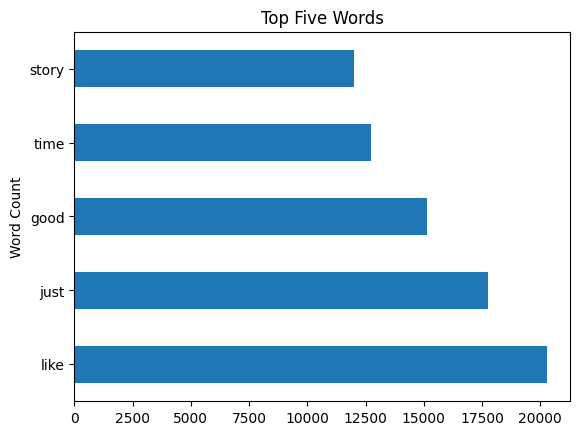

In [ ]:
fig = df_cv.sum().sort_values(ascending=False)[:5].plot(kind='barh', title='Top Five Words', 
                                                  xlabel='Word Count', ylabel='Words' ).figure 



In [ ]:
fig.savefig('Top_5_words.png')

# MultinomialNB

## Implementation from scratch

In [ ]:
class MultiNB:
    def __init__(self,alpha=1):
        self.alpha = alpha

    def get_params(self, deep=True):
        return {'alpha': self.alpha}

    def set_params(self, **params):
      if 'alpha' in params:
          self.alpha = params['alpha']
      return self
    
    def _prior(self): # CHECKED
        P = np.zeros((self.n_classes_))
        _, self.dist = np.unique(self.y,return_counts=True)
        for i in range(self.classes_.shape[0]):
            P[i] = self.dist[i] / self.n_samples

        print(P)
        return P

    def fit(self, X, y): # CHECKED, matches with sklearn
        """
            N_yi: 2D array. Contains for each class in y, the number of time each feature i appears under y.
            N_y: 1D array. Contains for each class in y, the number of all features appear under y. ?
        """
        self.y = y
        self.n_samples, self.n_features = X.shape # n_samples, n_features = (25000, 106879)
        self.classes_ = np.unique(y)              # classes_ = 2
        self.n_classes_ = self.classes_.shape[0]  # n_classes_ = 2?
        self.class_priors_ = self._prior()
        self.theta = np.zeros((2,self.n_features))
        
        # distinct values in each features
        self.uniques = []
        for i in range(self.n_features):
            tmp = np.unique(X[:,i])
            self.uniques.append( tmp )
            
        self.N_yi = np.zeros((self.n_classes_, self.n_features)) # feature count
        self.N_y = np.zeros((self.n_classes_)) # total count 
        self.row_sum = np.zeros((self.n_classes_, self.n_samples))
        for i in self.classes_: # x axis
            indices = np.argwhere(self.y==i).flatten()
            columnwise_sum = []
            for j in range(self.n_features): # y axis
                columnwise_sum.append(np.sum(X[indices,j]))
                
            self.N_yi[i] = columnwise_sum # 2d
            self.N_y[i] = np.sum(columnwise_sum) # 1d



################# compute theta (2 , 106xxx) ################
        for i in range(X.shape[0]): # i = 25000
            for h in self.classes_: # h = 0, 1
                Nyi = self.N_yi[h,:]
                #print(Nyi.shape)
                Ny  = self.N_y[h]
                Ny = np.full((self.n_features,), self.N_y[h])
                alphas = np.full((self.n_features,), self.alpha)
                #print(Ny.shape)
                #print(Ny)
                numerator = Nyi + alphas
                denominator = Ny + (alphas * self.n_features)

                #print(numerator,denominator)
                #print(X[i].shape)
                #print(X[i])

                self.theta[h,:] = numerator / denominator

                #self.theta[h,:] = np.power((numerator / denominator), X[i].toarray())
                #print(theta_i.shape)
                #print(theta_i)
 
        #print(self.theta)

In [ ]:
def logsumexp(Z):                                                # dimension C x N
        Zmax = np.max(Z,axis=0)[None,:]                              # max over C
        log_sum_exp = Zmax + np.log(np.sum(np.exp(Z - Zmax), axis=0))
        return log_sum_exp
            
def predict(self, X):
        Nt, D = X.shape
        log_prior = np.log(self.class_priors_)[:, None]
        

        feature_log_prob_ = np.log(self.theta)
        #feature_log_prob_ = classifier.feature_log_prob_
        log_likelihood = feature_log_prob_
        log_likelihood = X @ log_likelihood.T

        log_posterior = log_prior + log_likelihood.T
        posterior = np.exp(log_posterior - logsumexp(log_posterior))
        y_pred = np.argmax(posterior.T, 1)
        
        return y_pred

MultiNB.predict = predict

In [ ]:
from sklearn.metrics import accuracy_score
def evaluate_acc(yh,y):
    #y_pred = np.argmax(yh, 1)
    print("Accuracy is ", accuracy_score(y,yh))
    return accuracy_score(y,yh)

### Report the Performance (Simply set alpha = 1)

First report the performance setting alpha=1.
Vectorize the data using min_df=2 and max_df=0.5.

In [ ]:
##### directly vectorize ######
##### use this ########
vec = CountVectorizer(lowercase = True, stop_words = 'english', min_df=2, max_df = 0.5)
vec = vec.fit(df_train['text'])
X_train_cv = vec.transform(df_train['text'])
X_test_cv = vec.transform(df_test['text'])

In [ ]:
me = MultiNB(alpha=1)

In [ ]:
me.fit(X_train_cv, y_train)

[0.5 0.5]


In [ ]:
yhat = me.predict(X_test_cv)

In [ ]:
yhat

array([0, 0, 0, ..., 0, 0, 0])

In [ ]:
evaluate_acc(yhat, y_test)

Accuracy is  0.82228


0.82228

In [ ]:
from sklearn.metrics import confusion_matrix, ConfusionMatrixDisplay
cm = confusion_matrix(y_test, yhat)
cm

array([[11003,  1497],
       [ 2946,  9554]])

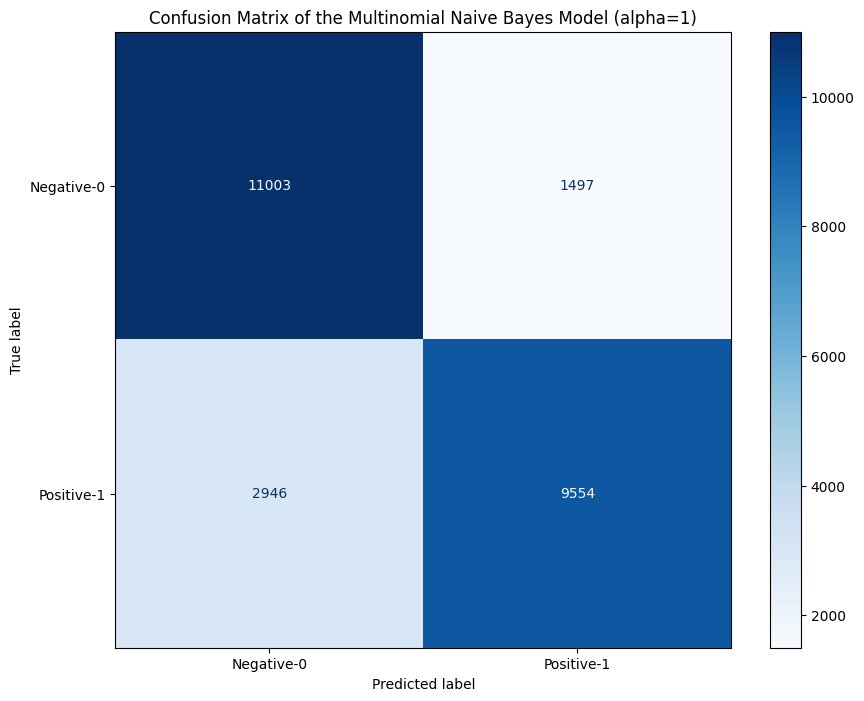

In [ ]:
class_names = ['Negative-0', 'Positive-1']
disp = ConfusionMatrixDisplay(confusion_matrix=cm, display_labels=class_names)
fig, ax = plt.subplots(figsize=(10, 8))
plt.title('Confusion Matrix of the Multinomial Naive Bayes Model (alpha=1)')
disp.plot(ax=ax, cmap='Blues', xticks_rotation='horizontal')
fig.savefig('cm_mnb.png')

In [ ]:
from sklearn.metrics import classification_report
report=classification_report(y_test, yhat,target_names=['Positive','Negative'])
print(report)

              precision    recall  f1-score   support

    Positive       0.79      0.88      0.83     12500
    Negative       0.86      0.76      0.81     12500

    accuracy                           0.82     25000
   macro avg       0.83      0.82      0.82     25000
weighted avg       0.83      0.82      0.82     25000



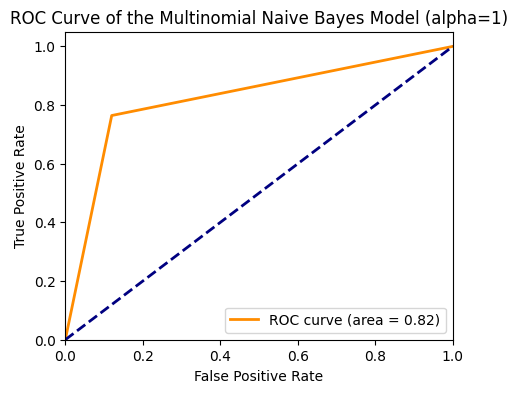

In [ ]:
from sklearn.metrics import roc_curve, auc

fpr, tpr, thresholds = roc_curve(y_test, yhat)
roc_auc = auc(fpr, tpr)

# plot ROC curve
plt.figure(figsize=(5, 4))
plt.plot(fpr, tpr, color='darkorange', lw=2, label='ROC curve (area = %0.2f)' % roc_auc)
plt.plot([0, 1], [0, 1], color='navy', lw=2, linestyle='--')
plt.xlim([0.0, 1.0])
plt.ylim([0.0, 1.05])
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('ROC Curve of the Multinomial Naive Bayes Model (alpha=1)')
plt.legend(loc="lower right")
plt.savefig('roc_mnb.png')

Using tuned paramaters

In [ ]:
##### directly vectorize ######
##### use this ########
vec = CountVectorizer(lowercase = True, stop_words = 'english', min_df=2, max_df = 0.5, max_features=4000)
vec = vec.fit(df_train['text'])
X_train_cv = vec.transform(df_train['text'])
X_test_cv = vec.transform(df_test['text'])

In [ ]:
me = MultiNB(alpha=2)

In [ ]:
me.fit(X_train_cv, y_train)

[0.5 0.5]


In [ ]:
yhat = me.predict(X_test_cv)

In [ ]:
yhat

array([0, 0, 0, ..., 1, 0, 0])

In [ ]:
evaluate_acc(yhat, y_test)

Accuracy is  0.83832


0.83832

In [ ]:
cm = confusion_matrix(y_test, yhat)
cm

array([[10750,  1750],
       [ 2292, 10208]])

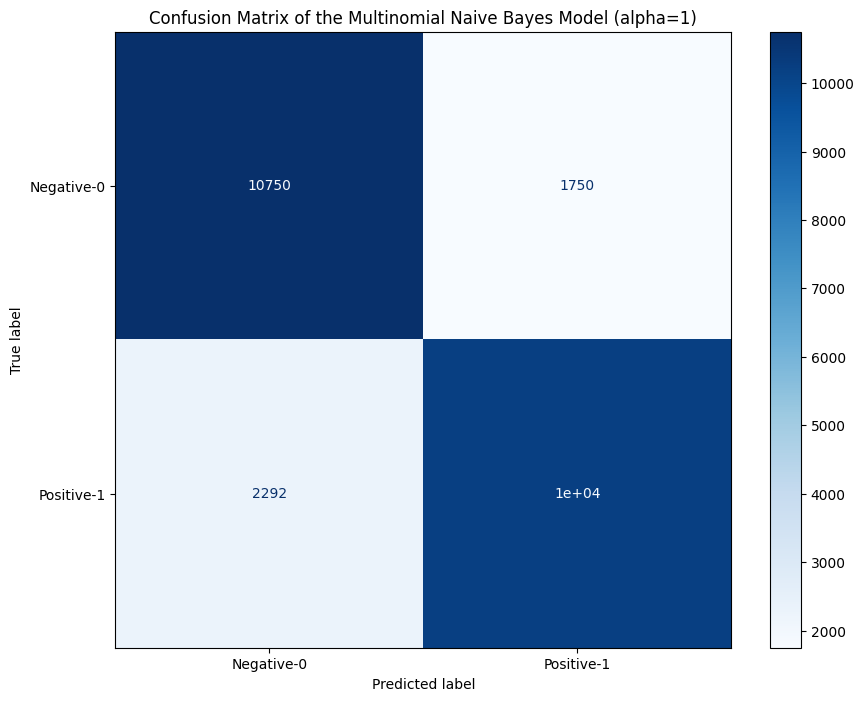

In [ ]:
class_names = ['Negative-0', 'Positive-1']
disp = ConfusionMatrixDisplay(confusion_matrix=cm, display_labels=class_names)
fig, ax = plt.subplots(figsize=(10, 8))
plt.title('Confusion Matrix of the Multinomial Naive Bayes Model (alpha=1)')
disp.plot(ax=ax, cmap='Blues', xticks_rotation='horizontal')
fig.savefig('cm_mnb.png')

In [ ]:
report=classification_report(y_test, yhat,target_names=['Positive','Negative'])
print(report)

              precision    recall  f1-score   support

    Positive       0.82      0.86      0.84     12500
    Negative       0.85      0.82      0.83     12500

    accuracy                           0.84     25000
   macro avg       0.84      0.84      0.84     25000
weighted avg       0.84      0.84      0.84     25000



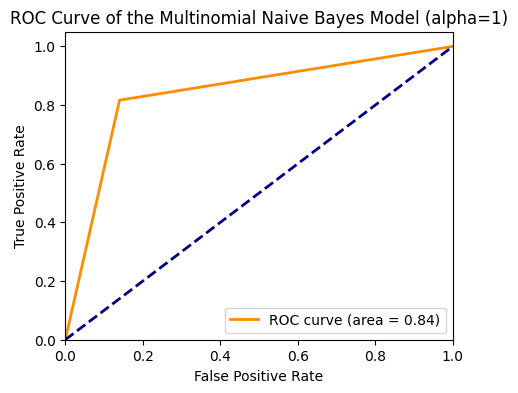

In [ ]:
fpr, tpr, thresholds = roc_curve(y_test, yhat)
roc_auc = auc(fpr, tpr)

# plot ROC curve
plt.figure(figsize=(5, 4))
plt.plot(fpr, tpr, color='darkorange', lw=2, label='ROC curve (area = %0.2f)' % roc_auc)
plt.plot([0, 1], [0, 1], color='navy', lw=2, linestyle='--')
plt.xlim([0.0, 1.0])
plt.ylim([0.0, 1.05])
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('ROC Curve of the Multinomial Naive Bayes Model (alpha=1)')
plt.legend(loc="lower right")
plt.savefig('roc_mnb.png')

# Improvements and Extra Experiments

## MNB

### Tuning alpha using 5-fold cross validation

Use the model from sklearn here to tune for much less run time

In [ ]:
classifier = MultinomialNB()

In [ ]:
alpha_ranges = {
    "alpha": np.arange(1, 100).tolist()
}

In [ ]:
from sklearn.model_selection import GridSearchCV

In [ ]:
grid_search = GridSearchCV(estimator=classifier,param_grid=alpha_ranges, cv=5, return_train_score=True,
                           scoring = 'accuracy')
grid_search.fit(X_train_cv, y_train)

GridSearchCV(cv=5, estimator=MultinomialNB(),
             param_grid={'alpha': [1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13,
                                   14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24,
                                   25, 26, 27, 28, 29, 30, ...]},
             return_train_score=True, scoring='accuracy')

In [ ]:
train_acc = grid_search.cv_results_['mean_train_score']
train_acc

array([0.90935, 0.90347, 0.89987, 0.89729, 0.89519, 0.89365, 0.89218,
       0.89072, 0.88969, 0.88848, 0.88756, 0.88657, 0.88582, 0.88509,
       0.88453, 0.88394, 0.8834 , 0.88301, 0.88271, 0.88222, 0.88172,
       0.88126, 0.88104, 0.88055, 0.88022, 0.87988, 0.87959, 0.87934,
       0.87899, 0.87857, 0.87827, 0.87811, 0.87779, 0.87749, 0.87719,
       0.8769 , 0.87654, 0.87629, 0.87612, 0.87579, 0.87562, 0.87534,
       0.87508, 0.8748 , 0.87451, 0.87437, 0.87424, 0.87405, 0.87388,
       0.87362, 0.87349, 0.87334, 0.8731 , 0.87297, 0.87277, 0.87265,
       0.87248, 0.87234, 0.87211, 0.87194, 0.87174, 0.87154, 0.87135,
       0.87122, 0.87111, 0.87102, 0.87094, 0.87083, 0.87072, 0.87051,
       0.87044, 0.87027, 0.86999, 0.86984, 0.86976, 0.86962, 0.86938,
       0.86925, 0.86908, 0.86891, 0.8687 , 0.86848, 0.86839, 0.86826,
       0.86812, 0.86798, 0.86786, 0.86772, 0.86757, 0.8674 , 0.86723,
       0.86717, 0.86705, 0.86694, 0.86687, 0.8667 , 0.86663, 0.86647,
       0.86643])

In [ ]:
train_std = grid_search.cv_results_['std_train_score']

test_acc = grid_search.cv_results_['mean_test_score']
test_std = grid_search.cv_results_['std_test_score']

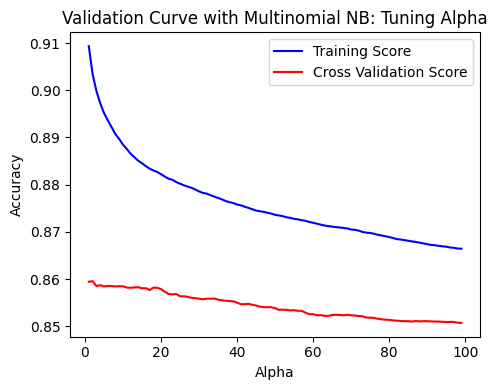

In [ ]:
plt.figure(figsize=(5,4))
alpha = np.arange(1, 100).tolist()
plt.plot(alpha, train_acc, label="Training Score", color='b')
plt.plot(alpha, test_acc, label="Cross Validation Score", color='r')

plt.title("Validation Curve with Multinomial NB: Tuning Alpha")
plt.xlabel("Alpha")
plt.ylabel("Accuracy")

plt.tight_layout()
plt.legend(loc = 'best')
plt.savefig('mnb_tuning_alpha.png')

In [ ]:
grid_search.best_params_

{'alpha': 2}

In [ ]:
grid_search.best_score_

0.8595600000000001

### Tuning feature size using *optuna*

In [ ]:
!pip install --quiet optuna

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 365.7/365.7 kB 6.7 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 212.3/212.3 kB 19.8 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 78.7/78.7 kB 6.1 MB/s eta 0:00:00


In [ ]:
import optuna
from optuna.samplers import TPESampler

In [ ]:
def objective(trial):
    # Define the search space for the hyperparameters
    #alpha = trial.suggest_float("alpha", 1e-2, 1e2, log=True)
    #max = trial.suggest_int("max feature size", 3000, 130000, step=1000, log=True)
    
    #alpha = trial.suggest_categorical("alpha", [0.001,0.1,0.5,1,5,10,30, 50, 100])

    max = trial.suggest_categorical("max feature size", np.arange(3000, 50000, 1000).tolist())



    vec = CountVectorizer(lowercase = True, stop_words = 'english', min_df=2, max_df = 0.5, max_features=max)
    vec = vec.fit(df_train['text'])
    X_train_cv = vec.transform(df_train['text'])
    X_test_cv = vec.transform(df_test['text'])

    classifier = MultinomialNB(alpha=2)
    classifier.fit(X_train_cv, y_train)

    # Train the model and compute its validation accuracy
    yhat = classifier.predict(X_test_cv)
    val_acc = accuracy_score(y_test, yhat)
    #val_acc = evaluate_acc(yhat, y_test)

    return val_acc

# Define the search method and run the optimization process
study = optuna.create_study(direction="maximize")
study.optimize(objective, n_trials=100)

# Print the best hyperparameters found by Optuna
print("Best hyperparameters: ", study.best_params)

[I 2023-04-14 01:16:09,095] A new study created in memory with name: no-name-ffa27725-62ed-4ba6-a9dc-36c01b4baf38
[I 2023-04-14 01:16:22,416] Trial 0 finished with value: 0.8376 and parameters: {'max feature size': 3000}. Best is trial 0 with value: 0.8376.
[I 2023-04-14 01:16:35,667] Trial 1 finished with value: 0.82512 and parameters: {'max feature size': 37000}. Best is trial 0 with value: 0.8376.
[I 2023-04-14 01:16:48,878] Trial 2 finished with value: 0.82516 and parameters: {'max feature size': 39000}. Best is trial 0 with value: 0.8376.
[I 2023-04-14 01:17:02,104] Trial 3 finished with value: 0.83068 and parameters: {'max feature size': 16000}. Best is trial 0 with value: 0.8376.
[I 2023-04-14 01:17:15,865] Trial 4 finished with value: 0.8274 and parameters: {'max feature size': 23000}. Best is trial 0 with value: 0.8376.
[I 2023-04-14 01:17:28,779] Trial 5 finished with value: 0.83516 and parameters: {'max feature size': 8000}. Best is trial 0 with value: 0.8376.
[I 2023-04-14 

Best hyperparameters:  {'max feature size': 4000}


In [ ]:
fig = optuna.visualization.plot_optimization_history(study)
fig.show()

In [ ]:
def objective(trial):
    # Define the search space for the hyperparameters
    #alpha = trial.suggest_float("alpha", 1e-2, 1e2, log=True)
    #max = trial.suggest_int("max feature size", 3000, 130000, step=1000, log=True)
    
    #alpha = trial.suggest_categorical("alpha", [0.001,0.1,0.5,1,5,10,30, 50, 100])

    max = trial.suggest_categorical("max feature size", np.arange(3000, 13000, 1000).tolist())



    vec = CountVectorizer(lowercase = True, stop_words = 'english', min_df=2, max_df = 0.5, max_features=max)
    vec = vec.fit(df_train['text'])
    X_train_cv = vec.transform(df_train['text'])
    X_test_cv = vec.transform(df_test['text'])

    classifier = MultinomialNB(alpha=2)
    classifier.fit(X_train_cv, y_train)

    # Train the model and compute its validation accuracy
    yhat = classifier.predict(X_test_cv)
    val_acc = accuracy_score(y_test, yhat)
    #val_acc = evaluate_acc(yhat, y_test)

    return val_acc

# Define the search method and run the optimization process
study = optuna.create_study(direction="maximize")
study.optimize(objective, n_trials=30)

# Print the best hyperparameters found by Optuna
print("Best hyperparameters: ", study.best_params)

[I 2023-04-14 01:52:48,027] A new study created in memory with name: no-name-531bfb79-d8a3-4812-99ce-d2665a1ba73f
[I 2023-04-14 01:53:02,753] Trial 0 finished with value: 0.83276 and parameters: {'max feature size': 11000}. Best is trial 0 with value: 0.83276.
[I 2023-04-14 01:53:16,587] Trial 1 finished with value: 0.8318 and parameters: {'max feature size': 12000}. Best is trial 0 with value: 0.83276.
[I 2023-04-14 01:53:30,565] Trial 2 finished with value: 0.83484 and parameters: {'max feature size': 7000}. Best is trial 2 with value: 0.83484.
[I 2023-04-14 01:53:44,315] Trial 3 finished with value: 0.8376 and parameters: {'max feature size': 3000}. Best is trial 3 with value: 0.8376.
[I 2023-04-14 01:53:58,175] Trial 4 finished with value: 0.83484 and parameters: {'max feature size': 7000}. Best is trial 3 with value: 0.8376.
[I 2023-04-14 01:54:12,034] Trial 5 finished with value: 0.83516 and parameters: {'max feature size': 8000}. Best is trial 3 with value: 0.8376.
[I 2023-04-14

Best hyperparameters:  {'max feature size': 4000}


In [ ]:
fig = optuna.visualization.plot_optimization_history(study)
fig.show()

### 5-fold cross validation using tuned alpha and feature size

In [ ]:
me = MultiNB(alpha=2)

In [10]:
from sklearn.naive_bayes import BernoulliNB, GaussianNB, MultinomialNB
from sklearn.metrics import accuracy_score

In [11]:
from sklearn.metrics import make_scorer
from sklearn.metrics import confusion_matrix

use tuned max_feature = 4000, alpha=2

In [ ]:
vec = CountVectorizer(lowercase = True, stop_words = 'english', min_df=2, max_df = 0.5, max_features=4000)
vec = vec.fit(df_train['text'])
X_train_cv = vec.transform(df_train['text'])
X_test_cv = vec.transform(df_test['text'])

In [ ]:
from sklearn.model_selection import cross_validate
scores = cross_validate(me, X_train_cv, y_train, cv=5, scoring='accuracy',
                        return_train_score=True)
scores

In [ ]:
print('Accuracy scores:', scores['test_score'])
print('Average accuracy:', np.mean(scores['test_score']))

Accuracy scores: [0.842  0.8542 0.8498 0.8374 0.8498]
Average accuracy: 0.8466400000000001


In [14]:
def cross_validation(model, _X, _y, _cv=5):
      '''Function to perform 5 Folds Cross-Validation
       Parameters
       ----------
      model: Python Class, default=None
              This is the machine learning algorithm to be used for training.
      _X: array
           This is the matrix of features.
      _y: array
           This is the target variable.
      _cv: int, default=5
          Determines the number of folds for cross-validation.
       Returns
       -------
       The function returns a dictionary containing the metrics 'accuracy', 'precision',
       'recall', 'f1' for both training set and validation set.
      '''
      _scoring = ['accuracy', 'precision', 'recall', 'f1']
      results = cross_validate(estimator=model,
                               X=_X,
                               y=_y,
                               cv=_cv,
                               scoring=_scoring,
                               return_train_score=True)
      
      return {"Training Accuracy scores": results['train_accuracy'],
              "Mean Training Accuracy": results['train_accuracy'].mean()*100,
              "Training Precision scores": results['train_precision'],
              "Mean Training Precision": results['train_precision'].mean(),
              "Training Recall scores": results['train_recall'],
              "Mean Training Recall": results['train_recall'].mean(),
              "Training F1 scores": results['train_f1'],
              "Mean Training F1 Score": results['train_f1'].mean(),
              "Validation Accuracy scores": results['test_accuracy'],
              "Mean Validation Accuracy": results['test_accuracy'].mean()*100,
              "Validation Precision scores": results['test_precision'],
              "Mean Validation Precision": results['test_precision'].mean(),
              "Validation Recall scores": results['test_recall'],
              "Mean Validation Recall": results['test_recall'].mean(),
              "Validation F1 scores": results['test_f1'],
              "Mean Validation F1 Score": results['test_f1'].mean()
              }

In [15]:
# Grouped Bar Chart for both training and validation data
def plot_result(x_label, y_label, plot_title, train_data, val_data):
        '''Function to plot a grouped bar chart showing the training and validation
          results of the ML model in each fold after applying K-fold cross-validation.
         Parameters
         ----------
         x_label: str, 
            Name of the algorithm used for training e.g 'Decision Tree'
          
         y_label: str, 
            Name of metric being visualized e.g 'Accuracy'
         plot_title: str, 
            This is the title of the plot e.g 'Accuracy Plot'
         
         train_result: list, array
            This is the list containing either training precision, accuracy, or f1 score.
        
         val_result: list, array
            This is the list containing either validation precision, accuracy, or f1 score.
         Returns
         -------
         The function returns a Grouped Barchart showing the training and validation result
         in each fold.
        '''
        
        # Set size of plot
        plt.figure(figsize=(12,6))
        labels = ["1st Fold", "2nd Fold", "3rd Fold", "4th Fold", "5th Fold"]
        X_axis = np.arange(len(labels))
        ax = plt.gca()
        plt.ylim(0.40000, 1)
        plt.bar(X_axis-0.2, train_data, 0.4, color='blue', label='Training')
        plt.bar(X_axis+0.2, val_data, 0.4, color='red', label='Validation')
        plt.title(plot_title, fontsize=30)
        plt.xticks(X_axis, labels)
        plt.xlabel(x_label, fontsize=14)
        plt.ylabel(y_label, fontsize=14)
        plt.legend()
        plt.grid(True)
        plt.savefig('mnb_cross_vali.png')
        plt.show()

In [ ]:
result_mnb = cross_validation(me, X_train_cv, y_train, 5)
print(result_mnb)

[0.49845 0.50155]
[0.5023 0.4977]
[0.4998 0.5002]
[0.5005 0.4995]
[0.49895 0.50105]
{'Training Accuracy scores': array([0.86025, 0.85855, 0.85895, 0.86055, 0.8586 ]), 'Mean Training Accuracy': 85.938, 'Training Precision scores': array([0.86486486, 0.86061342, 0.86281443, 0.86240564, 0.86026245]), 'Mean Training Precision': 0.8621921591544446, 'Training Recall scores': array([0.85494966, 0.85412899, 0.8537585 , 0.85765766, 0.8570003 ]), 'Mean Training Recall': 0.8554990206132065, 'Training F1 scores': array([0.85987868, 0.85735895, 0.85826257, 0.86002509, 0.85862827]), 'Mean Training F1 Score': 0.8588307135273234, 'Validation Accuracy scores': array([0.842 , 0.8542, 0.8498, 0.8374, 0.8498]), 'Mean Validation Accuracy': 84.664, 'Validation Precision scores': array([0.83728405, 0.86296444, 0.84830339, 0.83980777, 0.85322976]), 'Mean Validation Precision': 0.8483178835805862, 'Validation Recall scores': array([0.84406642, 0.84838963, 0.85136218, 0.83545817, 0.84187172]), 'Mean Validation 

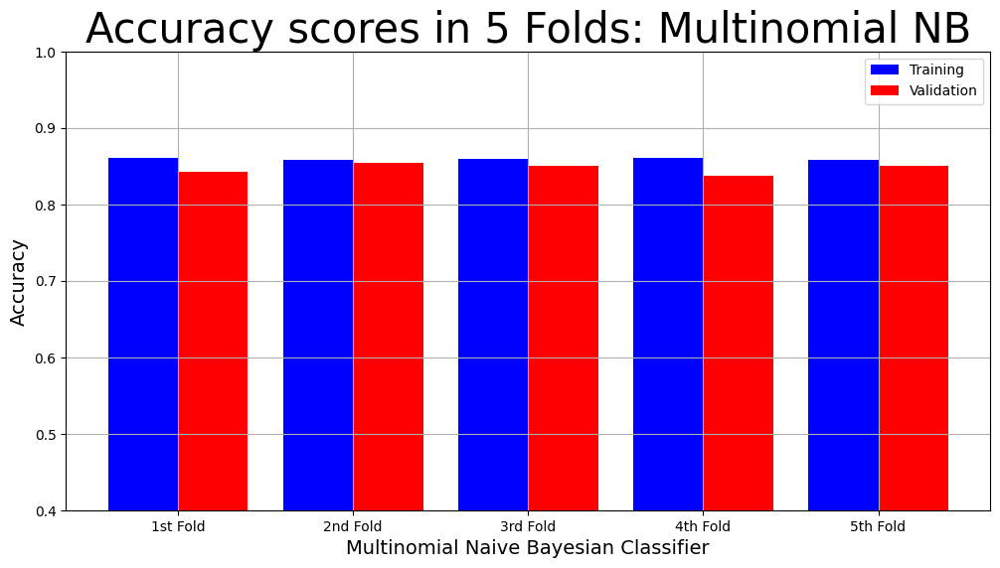

In [ ]:
model_name = "Multinomial Naive Bayesian Classifier"
plot_result(model_name,
            "Accuracy",
            "Accuracy scores in 5 Folds: Multinomial NB",
            result_mnb["Training Accuracy scores"],
            result_mnb["Validation Accuracy scores"])

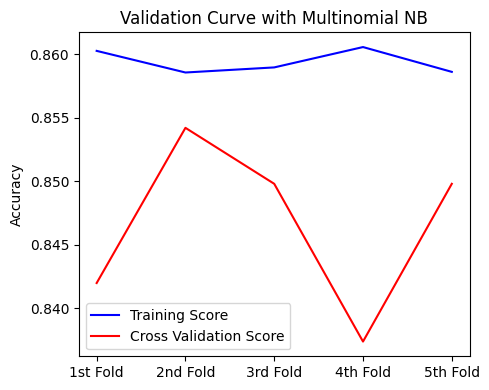

In [ ]:
plt.figure(figsize=(5,4))
labels = ["1st Fold", "2nd Fold", "3rd Fold", "4th Fold", "5th Fold"]
X_axis = np.arange(len(labels))

plt.plot(X_axis, result_mnb["Training Accuracy scores"], label="Training Score", color='b')
plt.plot(X_axis, result_mnb["Validation Accuracy scores"], label="Cross Validation Score", color='r')

plt.title("Validation Curve with Multinomial NB")
plt.ylabel("Accuracy")
plt.xticks(X_axis, labels)

plt.tight_layout()
plt.legend(loc = 'best')

plt.savefig('mnb_cross_vali_curves.png')
plt.show()

In [ ]:
print('Average training accuracy:', result_mnb['Mean Training Accuracy'])
print('Average testing accuracy:', np.mean(result_mnb['Mean Validation Accuracy']))

Average training accuracy: 85.938
Average testing accuracy: 84.664


## Gaussian Naive Bayes

### Implementation from scratch

In [1]:
class GaussianNaiveBayes:
    
    def __init__(self):
        return
    
    def fit(self, x, y):
        N, D = x.shape ## N,D = (25000, 106879)
        C = np.max(y) + 1 ## C=2
        # one parameter for each feature conditioned on each class
        mu, sigma = np.zeros((C,D)), np.zeros((C,D)) # 2, 106879
        Nc = np.zeros(C) # number of instances in class c
        # for each class get the MLE for the mean and std
        for c in range(C):
            x_c = x[y == c]                          #slice all the elements from class c
            #print(x_c.shape) # (12500, 106879)
            Nc[c] = x_c.shape[0]   # Nc[0] = 12500 , Nc[1] = 12500    #get number of elements of class c
            #print(np.mean(x_c, 0))
            mu[c,:] = np.mean(x_c,0)   
               #mean of features of class c
            sigma[c,:] = np.std(x_c.toarray(),0)               #std of features of class c
            
        self.mu = mu 
        #print(mu)                                 # C x D

        self.sigma = sigma 
        #print(sigma)                                 # C x D
                           # C x D
        self.pi = (Nc+1)/(N+C)   
        #print(self.pi)  #0.5 0.5                  #Laplace smoothing (using alpha_c=1 for all c) you can derive using Dirichlet's distribution
        return self

In [7]:
def logsumexp(Z):                                                # dimension C x N
    Zmax = np.max(Z,axis=0)[None,:]                              # max over C
    log_sum_exp = Zmax + np.log(np.sum(np.exp(Z - Zmax), axis=0))
    return log_sum_exp

def predict(self, xt):
    Nt, D = xt.shape
    # for numerical stability we work in the log domain
    # we add a dimension because this is added to the log-likelihood matrix 
    # that assigns a likelihood for each class (C) to each test point, and so it is C x N
    log_prior = np.log(self.pi)[:, None]
    #print(log_prior)
    # logarithm of the likelihood term for Gaussian 
    # the first two terms are the logarithm of the normalization term in the Gaussian and the final term is the exponent in the Gaussian. 
    # Notice that we are adding dimensions (using None) to model parameters and data to make this evaluation. 
    # The reason is that sigma and mu are C x D, while the data x is N x D. We operate on a C x N x D shape by increasing the number of dimensions when needed

    log_likelihood = -.5 * np.log(2*np.pi) - np.log(self.sigma[:,None,:]) -.5 * (((xt.toarray()[None,:,:] - self.mu[:,None,:])/self.sigma[:,None,:])**2)
    # now we sum over the feature dimension to get a C x N matrix (this has the log-likelihood for each class-test point combination)

    log_likelihood = np.sum(log_likelihood, axis=2)
    # posterior calculation
    log_posterior = log_prior + log_likelihood
    

    posterior = np.exp(log_posterior - logsumexp(log_posterior))
    y_pred = np.argmax(posterior.T, 1)
   #print(posterior)
    return y_pred                                                 # dimension N x C

GaussianNaiveBayes.predict = predict

#### Performance

max_feature = 3000

In [8]:
###### without lemmatizer ######
vec = CountVectorizer(lowercase = True, stop_words = 'english', min_df=2, max_df = 0.5, max_features=3000)
vec = vec.fit(df_train['text'])
X_train_cv = vec.transform(df_train['text'])
X_test_cv = vec.transform(df_test['text'])

In [ ]:
model = GaussianNaiveBayes()
model.fit(X_train_cv, y_train)

In [ ]:
y_prob = model.predict(X_test_cv)

In [ ]:
evaluate_acc(y_prob, y_test)

Accuracy is  0.72952


0.72952

In [ ]:
sk = GaussianNB().fit(X_train_cv.toarray(),y_train)
sk.score(X_test_cv.toarray(),y_test)

0.72952

In [ ]:
cm = confusion_matrix(y_test, y_prob)
cm

array([[10858,  1642],
       [ 5120,  7380]])

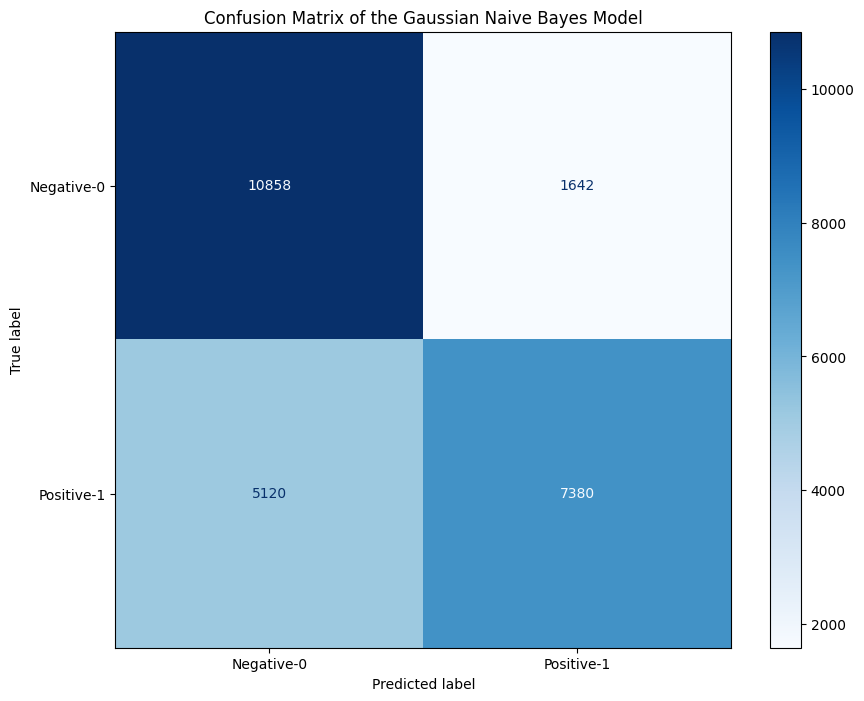

In [ ]:
class_names = ['Negative-0', 'Positive-1']
disp = ConfusionMatrixDisplay(confusion_matrix=cm, display_labels=class_names)
fig, ax = plt.subplots(figsize=(10, 8))
plt.title('Confusion Matrix of the Gaussian Naive Bayes Model')
disp.plot(ax=ax, cmap='Blues', xticks_rotation='horizontal')
fig.savefig('cm_gnb.png')

In [ ]:
report=classification_report(y_test, y_prob,target_names=['Positive','Negative'])
print(report)

              precision    recall  f1-score   support

    Positive       0.68      0.87      0.76     12500
    Negative       0.82      0.59      0.69     12500

    accuracy                           0.73     25000
   macro avg       0.75      0.73      0.72     25000
weighted avg       0.75      0.73      0.72     25000



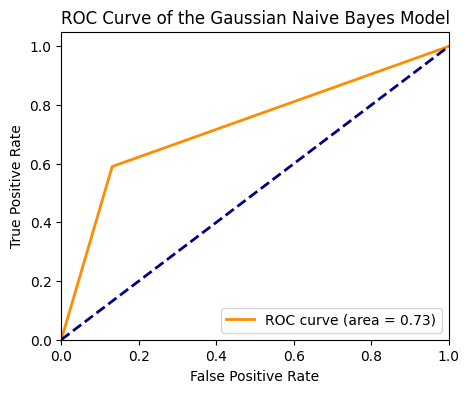

In [ ]:
fpr, tpr, thresholds = roc_curve(y_test, y_prob)
roc_auc = auc(fpr, tpr)

# plot ROC curve
plt.figure(figsize=(5, 4))
plt.plot(fpr, tpr, color='darkorange', lw=2, label='ROC curve (area = %0.2f)' % roc_auc)
plt.plot([0, 1], [0, 1], color='navy', lw=2, linestyle='--')
plt.xlim([0.0, 1.0])
plt.ylim([0.0, 1.05])
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('ROC Curve of the Gaussian Naive Bayes Model')
plt.legend(loc="lower right")
plt.savefig('roc_gnb.png')

### Tuning var_smoothing

In [ ]:
classifier = GaussianNB()

params_NB = {'var_smoothing': np.logspace(0,-9, num=100)}
gs_NB = GridSearchCV(estimator=classifier, return_train_score=True,
                 param_grid=params_NB, 
                 cv=5,   # use any cross validation technique 
                 verbose=1, 
                 scoring='accuracy') 
gs_NB.fit(X_train_cv.toarray(), y_train)

gs_NB.best_params_

Fitting 5 folds for each of 100 candidates, totalling 500 fits


{'var_smoothing': 1.519911082952933e-09}

In [ ]:
gs_NB.best_score_

0.7545200000000001

In [ ]:
var_smoothing = np.logspace(0,-9, num=100)

In [ ]:
train_acc = gs_NB.cv_results_['mean_train_score']
train_acc

array([0.52126, 0.52508, 0.52892, 0.53361, 0.53867, 0.54401, 0.5496 ,
       0.55577, 0.56241, 0.56939, 0.57698, 0.58449, 0.59241, 0.60119,
       0.61122, 0.62153, 0.6328 , 0.64359, 0.65493, 0.66705, 0.6786 ,
       0.69003, 0.69996, 0.70976, 0.71879, 0.72767, 0.73539, 0.74214,
       0.74799, 0.75365, 0.75864, 0.76229, 0.76532, 0.76754, 0.76955,
       0.77107, 0.77246, 0.77338, 0.77421, 0.77507, 0.77584, 0.77619,
       0.77657, 0.77683, 0.77716, 0.7774 , 0.77764, 0.77778, 0.77799,
       0.77805, 0.77818, 0.77824, 0.77832, 0.77837, 0.77847, 0.77847,
       0.77844, 0.77854, 0.77854, 0.77855, 0.77859, 0.77857, 0.77856,
       0.77857, 0.77858, 0.7786 , 0.7786 , 0.77859, 0.77862, 0.77864,
       0.77867, 0.77868, 0.77867, 0.7787 , 0.77871, 0.7787 , 0.77868,
       0.77868, 0.77871, 0.77871, 0.77873, 0.77875, 0.77876, 0.77875,
       0.77875, 0.77877, 0.77877, 0.77881, 0.77878, 0.7788 , 0.77882,
       0.77883, 0.77885, 0.77885, 0.77886, 0.77892, 0.77892, 0.77891,
       0.77894, 0.77

In [ ]:
train_std = gs_NB.cv_results_['std_train_score']
test_acc = gs_NB.cv_results_['mean_test_score']
test_std = gs_NB.cv_results_['std_test_score']
test_acc

array([0.51948, 0.52232, 0.5258 , 0.53016, 0.53376, 0.53856, 0.54428,
       0.55012, 0.55524, 0.56152, 0.56792, 0.5744 , 0.58176, 0.58992,
       0.59908, 0.60888, 0.61756, 0.62856, 0.63908, 0.64932, 0.661  ,
       0.67036, 0.6808 , 0.6896 , 0.6988 , 0.70588, 0.71204, 0.71892,
       0.72528, 0.73028, 0.7356 , 0.73916, 0.74232, 0.74452, 0.7468 ,
       0.7488 , 0.75012, 0.75112, 0.75152, 0.75184, 0.75212, 0.75256,
       0.75244, 0.7528 , 0.75284, 0.75312, 0.75364, 0.75376, 0.75384,
       0.75396, 0.75416, 0.75412, 0.75416, 0.75404, 0.75408, 0.75412,
       0.7542 , 0.7542 , 0.75408, 0.7542 , 0.7542 , 0.7542 , 0.7542 ,
       0.7542 , 0.7542 , 0.7542 , 0.7542 , 0.75424, 0.75424, 0.75424,
       0.75428, 0.75428, 0.75432, 0.75432, 0.75432, 0.75436, 0.75436,
       0.75436, 0.75428, 0.75428, 0.75424, 0.75424, 0.75428, 0.75428,
       0.75432, 0.75432, 0.75432, 0.75432, 0.75436, 0.75436, 0.75436,
       0.75436, 0.75436, 0.75436, 0.7544 , 0.7544 , 0.75448, 0.75452,
       0.75452, 0.75

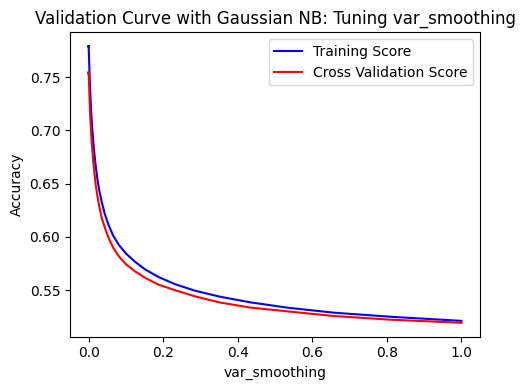

In [ ]:
plt.figure(figsize=(5,4))
plt.plot(var_smoothing, train_acc, label="Training Score", color='b')
plt.plot(var_smoothing, test_acc, label="Cross Validation Score", color='r')

plt.title("Validation Curve with Gaussian NB: Tuning var_smoothing")
plt.xlabel("var_smoothing")
plt.ylabel("Accuracy")

plt.tight_layout()
plt.legend(loc = 'best')
plt.savefig('gnb_tuning.png')
plt.show()

### Tuning Feature Size (3000) (omit)

In [ ]:
def objective(trial):
    # Define the search space for the hyperparameters
    #alpha = trial.suggest_float("alpha", 1e-2, 1e2, log=True)
    #max = trial.suggest_int("max feature size", 3000, 130000, step=1000, log=True)
    
    #alpha = trial.suggest_categorical("alpha", [0.001,0.1,0.5,1,5,10,30, 50, 100])

    max = trial.suggest_categorical("max feature size", np.arange(3000, 102000, 1000).tolist())



    vec = CountVectorizer(lowercase = True, stop_words = 'english', min_df=2, max_df = 0.5, max_features=max)
    vec = vec.fit(df_train['text'])
    X_train_cv = vec.transform(df_train['text'])
    X_test_cv = vec.transform(df_test['text'])

    classifier = GaussianNB(var_smoothing = 1.873817422860383e-08)
    classifier.fit(X_train_cv.toarray(), y_train)

    # Train the model and compute its validation accuracy
    yhat = classifier.predict(X_test_cv.toarray())
    val_acc = accuracy_score(y_test, yhat)
    #val_acc = evaluate_acc(yhat, y_test)

    return val_acc

# Define the search method and run the optimization process
study = optuna.create_study(direction="maximize")
study.optimize(objective, n_trials=10)

# Print the best hyperparameters found by Optuna
print("Best hyperparameters: ", study.best_params)

[I 2023-04-08 20:34:08,147] A new study created in memory with name: no-name-88447389-ddae-4c33-8aa3-efed1b9e1e04
[I 2023-04-08 20:34:36,991] Trial 0 finished with value: 0.5982 and parameters: {'max feature size': 30000}. Best is trial 0 with value: 0.5982.
[I 2023-04-08 20:34:49,975] Trial 1 finished with value: 0.71428 and parameters: {'max feature size': 4000}. Best is trial 1 with value: 0.71428.
[I 2023-04-08 20:35:32,800] Trial 2 finished with value: 0.57916 and parameters: {'max feature size': 83000}. Best is trial 1 with value: 0.71428.
[I 2023-04-08 20:36:08,498] Trial 3 finished with value: 0.57916 and parameters: {'max feature size': 51000}. Best is trial 1 with value: 0.71428.
[I 2023-04-08 20:36:44,115] Trial 4 finished with value: 0.57916 and parameters: {'max feature size': 89000}. Best is trial 1 with value: 0.71428.
[I 2023-04-08 20:37:11,856] Trial 5 finished with value: 0.5982 and parameters: {'max feature size': 30000}. Best is trial 1 with value: 0.71428.
[I 2023-

Best hyperparameters:  {'max feature size': 4000}


In [ ]:
fig = optuna.visualization.plot_optimization_history(study)
fig.show()

### Cross validation

In [18]:
classifier = GaussianNB(var_smoothing = 1.519911082952933e-09)
scores = cross_validate(classifier, X_train_cv.toarray(), y_train, cv=5, scoring='accuracy',return_train_score=True)
scores

{'fit_time': array([1.05748534, 2.91595221, 1.64219546, 3.24119353, 2.44483232]),
 'score_time': array([0.21903253, 0.61534977, 0.39580464, 0.36220026, 0.27416611]),
 'test_score': array([0.7422, 0.7562, 0.7552, 0.7578, 0.7612]),
 'train_score': array([0.77895, 0.7771 , 0.77895, 0.78175, 0.7778 ])}

In [19]:
classifier = GaussianNB(var_smoothing = 1.519911082952933e-09)
result_gnb = cross_validation(classifier, X_train_cv.toarray(), y_train, 5)
print(result_gnb)

{'Training Accuracy scores': array([0.77895, 0.7771 , 0.77895, 0.78175, 0.7778 ]), 'Mean Training Accuracy': 77.891, 'Training Precision scores': array([0.85877814, 0.85425722, 0.85612154, 0.85534115, 0.85155657]), 'Mean Training Precision': 0.8552109232078895, 'Training Recall scores': array([0.6677, 0.6682, 0.6706, 0.6782, 0.6729]), 'Mean Training Recall': 0.6715199999999999, 'Training F1 scores': array([0.75127989, 0.74985972, 0.75208882, 0.75653968, 0.75175958]), 'Mean Training F1 Score': 0.7523055399509669, 'Validation Accuracy scores': array([0.7422, 0.7562, 0.7552, 0.7578, 0.7612]), 'Mean Validation Accuracy': 75.45200000000001, 'Validation Precision scores': array([0.80442433, 0.82728666, 0.82451679, 0.82048732, 0.83487179]), 'Mean Validation Precision': 0.8223173794120748, 'Validation Recall scores': array([0.64  , 0.6476, 0.6484, 0.66  , 0.6512]), 'Mean Validation Recall': 0.64944, 'Validation F1 scores': array([0.71285364, 0.72649764, 0.72592924, 0.73154511, 0.73168539]), 'M

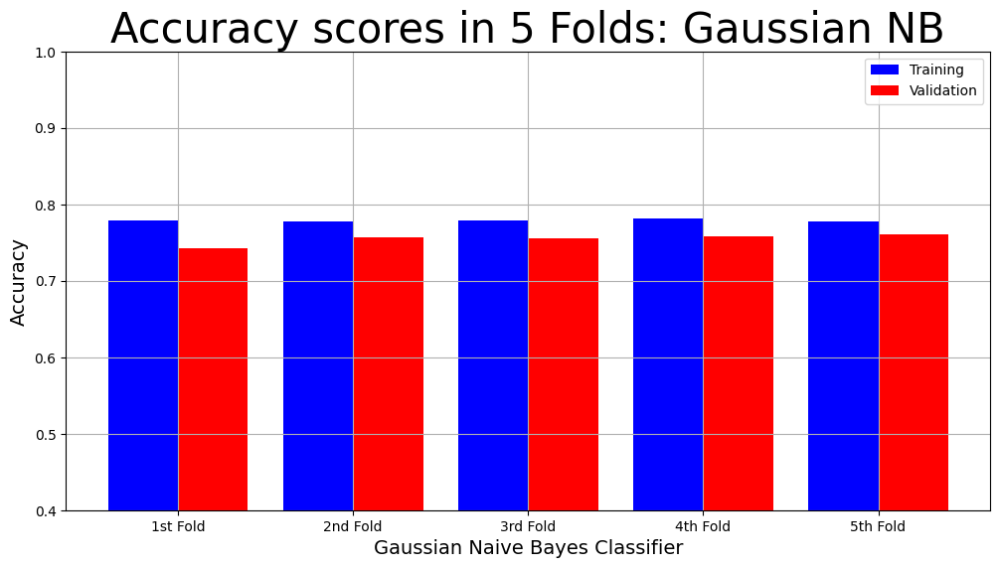

In [ ]:
model_name = "Gaussian Naive Bayes Classifier"
plot_result(model_name,
            "Accuracy",
            "Accuracy scores in 5 Folds: Gaussian NB",
            result_gnb["Training Accuracy scores"],
            result_gnb["Validation Accuracy scores"])

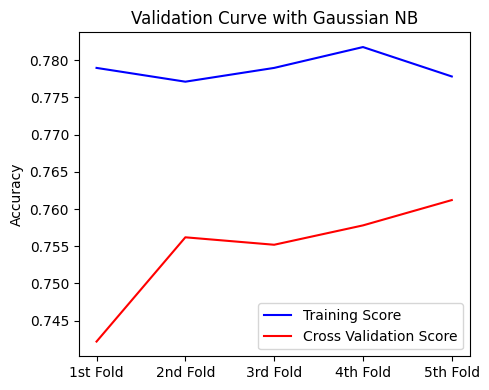

In [ ]:
plt.figure(figsize=(5,4))
labels = ["1st Fold", "2nd Fold", "3rd Fold", "4th Fold", "5th Fold"]
X_axis = np.arange(len(labels))

plt.plot(X_axis, result_gnb["Training Accuracy scores"], label="Training Score", color='b')
plt.plot(X_axis, result_gnb["Validation Accuracy scores"], label="Cross Validation Score", color='r')

plt.title("Validation Curve with Gaussian NB")
plt.ylabel("Accuracy")
plt.xticks(X_axis, labels)

plt.tight_layout()
plt.legend(loc = 'best')
plt.savefig('gnb_curves.png')
plt.show()

In [20]:
print('Average training accuracy:', result_gnb['Mean Training Accuracy'])
print('Average testing accuracy:', np.mean(result_gnb['Mean Validation Accuracy']))

Average training accuracy: 77.891
Average testing accuracy: 75.45200000000001


## Comparing MNB to GNB

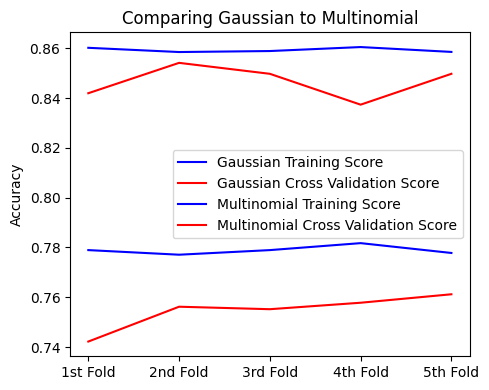

In [ ]:
plt.figure(figsize=(5,4))
labels = ["1st Fold", "2nd Fold", "3rd Fold", "4th Fold", "5th Fold"]
X_axis = np.arange(len(labels))

plt.plot(X_axis, result_gnb["Training Accuracy scores"], label="Gaussian Training Score", color='b')
plt.plot(X_axis, result_gnb["Validation Accuracy scores"], label="Gaussian Cross Validation Score", color='r')
plt.plot(X_axis, result_mnb["Training Accuracy scores"], label="Multinomial Training Score", color='b')
plt.plot(X_axis, result_mnb["Validation Accuracy scores"], label="Multinomial Cross Validation Score", color='r')


plt.title("Comparing Gaussian to Multinomial")
plt.ylabel("Accuracy")
plt.xticks(X_axis, labels)

plt.tight_layout()
plt.legend(loc = 'best')
plt.savefig('gnb_mnb.png')
plt.show()

# Tasks

## Task3.1 Comparing MNB to BERT

remember to compare using the model from scratch

In a single table, compare and report the performance of the Naive Bayes and BERT models on the IMDB Reviews classification task, and highlight the winner.


## Task3.2

In [ ]:
te, label = next(iter(test_ds))
input_text_cr = te[0:1]  # select the first document in the batch
input_text_wr = te[1:2]

In [ ]:
input_text_cr_str = input_text_cr.numpy()[0].decode('utf-8')
input_text_wr_str = input_text_wr.numpy()[0].decode('utf-8')

In [ ]:
input_text_cr_str

In [ ]:
input_text_wr_str

In [ ]:
sentence_a = input_text_cr_str[:110]
sentence_b = input_text_wr_str[:120]

In [ ]:
sentence_a

In [ ]:
sentence_b

In [ ]:
from transformers import AutoTokenizer, AutoModel, utils
utils.logging.set_verbosity_error()  # Suppress standard warnings
tokenizer = AutoTokenizer.from_pretrained("bert-base-uncased")
model = AutoModel.from_pretrained("bert-base-uncased", output_attentions=True)

In [ ]:
from bertviz.transformers_neuron_view import BertModel, BertTokenizer
from bertviz.neuron_view import show
from bertviz import head_view, model_view
model_type = 'bert'
model_version = 'bert-base-uncased'
model = BertModel.from_pretrained(model_version, output_attentions=True)
tokenizer = BertTokenizer.from_pretrained(model_version, do_lower_case=True)

100%|██████████| 231508/231508 [00:00<00:00, 1264576.17B/s]


In [ ]:
show(model, model_type, tokenizer, input_text_cr_str[:110], display_mode='light',layer=4, head=3)

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

In [ ]:
show(model, model_type, tokenizer, input_text_wr_str[:110], display_mode='light',layer=4, head=3)

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

In [ ]:
inputs_cr = tokenizer.encode(sentence_a)
outputs_cr = model(inputs_cr)
attention_cr = outputs_cr[-1]  # Output includes attention weights when output_attentions=True
tokens_cr = tokenizer.convert_ids_to_tokens(inputs_cr[0]) 

TypeError: ignored

In [ ]:
head_view(attention_cr, tokens_cr)

In [ ]:
model_view(attention_cr, tokens_cr)

In [ ]:
show(model, model_type, tokenizer, sentence_b, display_mode='light',layer=4, head=3)

In [ ]:
inputs_wr = tokenizer.encode(sentence_b, return_tensors='pt')
outputs_wr = model(inputs_wr)
attention_wr = outputs_wr[-1]  # Output includes attention weights when output_attentions=True
tokens_wr = tokenizer.convert_ids_to_tokens(inputs_wr[0]) 

In [ ]:
head_view(attention_wr, tokens_wr)

In [ ]:
model_view(attention_wr, tokens_wr)